# Data Analysis for Datasets

In [483]:
import torch
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import plotly.express as px

## Data Preprocessing

In [484]:
train_data_df = pd.read_csv('../TED/CMAPSSData/train_FD004.txt', sep=' ', header = None)
test_data_df = pd.read_csv('../TED/CMAPSSData/test_FD004.txt', sep=' ', header = None)
test_labels_df = pd.read_csv('../TED/CMAPSSData/RUL_FD004.txt', sep=' ', header = None)

train_data_df.drop(train_data_df.columns[[-1, -2]], axis=1, inplace=True)
test_data_df.drop(test_data_df.columns[[-1, -2]], axis=1, inplace=True)
test_labels_df.drop(test_labels_df.columns[[-1]], axis=1, inplace=True)

### Extracting labels and organising the data

In [485]:
column_names = ['ID', 'Cycle', 'OpSet1', 'OpSet2', 'OpSet3', 'SensorMeasure1', 'SensorMeasure2', 'SensorMeasure3', 'SensorMeasure4', 'SensorMeasure5', 'SensorMeasure6', 'SensorMeasure7', 'SensorMeasure8', 'SensorMeasure9', 'SensorMeasure10', 'SensorMeasure11', 'SensorMeasure12', 'SensorMeasure13', 'SensorMeasure14', 'SensorMeasure15', 'SensorMeasure16', 'SensorMeasure17', 'SensorMeasure18', 'SensorMeasure19', 'SensorMeasure20', 'SensorMeasure21']

train_data_df.columns = column_names
max_cycles_train_df = train_data_df.groupby(['ID'], sort=False)['Cycle'].max().reset_index().rename(columns={'Cycle':'MaxCycleID'})

train_data_df = pd.merge(train_data_df, max_cycles_train_df, how='inner', on='ID')
train_data_df['RUL'] = train_data_df['MaxCycleID'] - train_data_df['Cycle']
train_data_df.drop(columns=['MaxCycleID'], inplace=True)

test_data_df.columns = column_names
max_cycles_test_df = test_data_df.groupby(['ID'], sort=False)['Cycle'].max().reset_index().rename(columns={'Cycle':'MaxCycleID'})

test_labels_df.columns = ['RUL']
test_labels_df['ID'] = max_cycles_test_df['ID']
test_labels_df['RUL'] = test_labels_df['RUL'] + max_cycles_test_df['MaxCycleID']

test_data_df = pd.merge(test_data_df, test_labels_df, how='inner', on='ID')
test_data_df['RUL'] = test_data_df['RUL'] - test_data_df['Cycle']

### Divide by engine

In [486]:
train_grouppby = train_data_df.groupby(['ID'], sort=False)
test_groupby = test_data_df.groupby(['ID'], sort=False)

### Graphs: Data before analysed

In [487]:
sensor_names = []
for i in range(3):
    sensor_names.append('OpSet' + str(i+1))
for i in range(21):
    sensor_names.append('SensorMeasure' + str(i+1))

In [488]:
train_groupby_arr = []
for i in range(len(train_grouppby)):
    train_groupby_arr.append(train_grouppby.get_group(i+1))

for i in range(len(train_grouppby)):
    train_groupby_arr[i] = train_groupby_arr[i].to_numpy()

test_groupby_arr = []
for i in range(len(test_groupby)):
    test_groupby_arr.append(test_groupby.get_group(i+1))

for i in range(len(test_groupby)):
    test_groupby_arr[i] = test_groupby_arr[i].to_numpy()

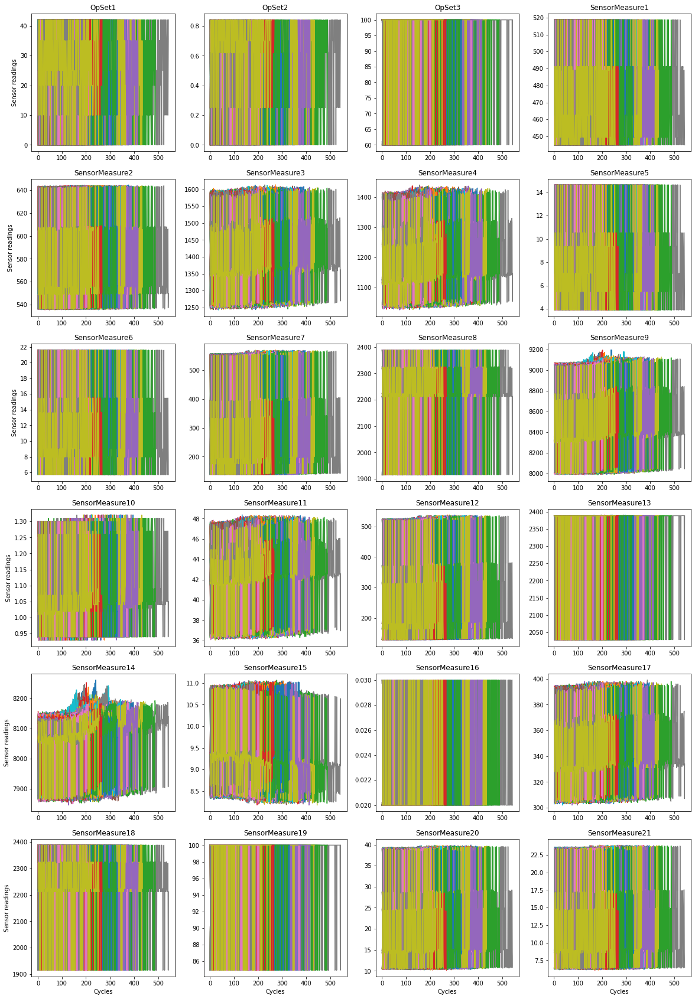

In [489]:
fig, axs = plt.subplots(6, 4)
flat_axs = axs.flatten()
for sensor in range(2, 26):
    flat_axs[sensor - 2].set_title(sensor_names[sensor - 2])
    for engine in range(len(train_groupby_arr)):
        flat_axs[sensor - 2].plot(train_groupby_arr[engine][:, 1], train_groupby_arr[engine][:, sensor])

plt.setp(axs[-1, :], xlabel='Cycles')
plt.setp(axs[:, 0], ylabel='Sensor readings')
fig.set_size_inches(20, 30) 
plt.savefig('fd004-sensors_unprocessed.jpg')
plt.show()

### Performing PCA to the dataset as a whole - Cluster Exploration

In [490]:
sensor_names = []
for i in range(21):
    sensor_names.append('SensorMeasure' + str(i+1))

sensor_values = train_data_df[sensor_names].values
sc = StandardScaler()
scaled_values = sc.fit_transform(sensor_values)

pca = PCA(n_components = 0.99)
pca_values = pca.fit_transform(scaled_values)

Number of components: 3


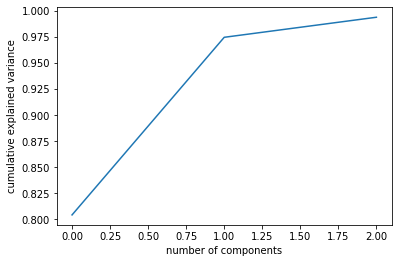

In [491]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
print("Number of components: " + str(pca.n_components_))

In [492]:
pd.DataFrame(pca.components_, columns = sensor_names)

,SensorMeasure1,SensorMeasure2,SensorMeasure3,SensorMeasure4,SensorMeasure5,SensorMeasure6,SensorMeasure7,SensorMeasure8,SensorMeasure9,SensorMeasure10,...,SensorMeasure12,SensorMeasure13,SensorMeasure14,SensorMeasure15,SensorMeasure16,SensorMeasure17,SensorMeasure18,SensorMeasure19,SensorMeasure20,SensorMeasure21
0,0.212418,0.237859,0.242151,0.242100,0.208806,0.218642,0.229312,0.214207,0.242183,0.232795,...,0.229429,0.146270,0.184195,-0.214243,0.204627,0.242224,0.214147,0.146261,0.226540,0.226530
1,0.243353,0.076705,-0.012908,0.033480,0.269542,0.229686,0.174025,-0.243568,-0.023288,0.030900,...,0.173299,-0.420755,-0.324296,0.237376,0.130435,-0.010344,-0.243773,-0.420734,0.190171,0.190219
2,0.221659,0.221257,0.115280,-0.024856,0.066622,0.063161,0.032729,0.161592,0.105215,-0.407031,...,0.032105,0.077491,-0.272120,0.173825,-0.718410,0.114562,0.161680,0.077850,0.037035,0.037173


In [493]:
n_pcs = pca.n_components_
most_important = [np.abs(pca.components_[i]).argmax() for i in range(n_pcs)]
initial_feature_names = sensor_names
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]

print(most_important_names)

['SensorMeasure17', 'SensorMeasure13', 'SensorMeasure16']


### PCA - Plots

In [494]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    pca_values,
    labels=labels,
    dimensions=range(n_pcs),
    color=train_data_df['ID']
)
fig.update_traces(diagonal_visible=False)
fig.show()
fig.write_html("fd004-PCA-matrix_plot.html")

In [495]:
fig = px.scatter_3d(pca_values, x=0, y=1, z=2, color=train_data_df['ID'])
fig.show()
fig.write_html("fd004-PCA-3d_plot.html")

### Eliminating the effect of the operational conditions (FD004 & FD004)

After arriving to a set of clear clusters (7 in this case) but each one consisted of datapoints from many different engines, we can be certain that it is not true that each engine performs under a specific operating condition only. It is because of this that it is necessary to have a second look around the operational settings, in order to spot possible patterns. After doing so I arrived to a clear 6 groups of operational sensor values (reported below)

In [496]:
train_data_df['OpSet1'] = train_data_df['OpSet1'].round()
train_data_df['OpSet2'] = train_data_df['OpSet2'].round(decimals=2)

train_data_df.groupby(by=['OpSet1', 'OpSet2', 'OpSet3']).size()

OpSet1  OpSet2  OpSet3
0.0     0.00    100.0      9238
10.0    0.25    100.0      9224
20.0    0.70    100.0      9091
25.0    0.62    60.0       9139
35.0    0.84    100.0      9162
42.0    0.84    100.0     15395
dtype: int64

In [497]:
train_processed = train_data_df.copy()
test_processed = test_data_df.copy()

train_processed['OpSet1'] = train_processed['OpSet1'].round()
train_processed['OpSet2'] = train_processed['OpSet2'].round(decimals=2)

test_processed['OpSet1'] = test_processed['OpSet1'].round()
test_processed['OpSet2'] = test_processed['OpSet2'].round(decimals=2)

def encode(op1, op2, op3):
    encoder_arr = [0 for val in op1]
    for i in range(len(op1)):
        if op1[i] == 0.00 and op2[i] == 0.00 and op3[i] == 100.00:
            encoder_arr[i] = 1
        elif op1[i] == 10.0 and op2[i] == 0.25 and op3[i] == 100.00:
            encoder_arr[i] = 2
        elif op1[i] == 20.0 and op2[i] == 0.70 and op3[i] == 100.00:
            encoder_arr[i] = 3
        elif op1[i] == 25.0 and op2[i] == 0.62 and op3[i] == 60.00:
            encoder_arr[i] = 4
        elif op1[i] == 35.0 and op2[i] == 0.84 and op3[i] == 100.00:
            encoder_arr[i] = 5
        elif op1[i] == 42.0 and op2[i] == 0.84 and op3[i] == 100.00:
            encoder_arr[i] = 6
        else:
            print("WHAT")
    return encoder_arr

train_op1 = train_processed['OpSet1'].values
train_op2 = train_processed['OpSet2'].values
train_op3 = train_processed['OpSet3'].values

test_op1 = test_processed['OpSet1'].values
test_op2 = test_processed['OpSet2'].values
test_op3 = test_processed['OpSet3'].values

train_encoder = encode(train_op1, train_op2, train_op3)
test_encoder = encode(test_op1, test_op2, test_op3)

train_encoder_df = pd.DataFrame(np.array(train_encoder), columns=['Encoding'])
train_encoder_df['Engine ID'] = train_processed['ID']

test_encoder_df = pd.DataFrame(np.array(test_encoder), columns=['Encoding'])
test_encoder_df['Engine ID'] = test_processed['ID']

training_labels_df = train_processed.pop('RUL')
testing_labels_df = test_processed.pop('RUL')

In [498]:
training_labels_df.to_csv('./fd004-training_labels.csv', sep=' ', columns=['RUL'], index=False)
testing_labels_df.to_csv('./fd004-testing_labels.csv', sep=' ', columns=['RUL'], index=False)

In [499]:
sensor_names = []
sensor_names.append('ID')
sensor_names.append('Cycle')
for i in range(3):
    sensor_names.append('OpSet' + str(i+1))
for i in range(21):
    sensor_names.append('SensorMeasure' + str(i+1))

train_grouped = train_processed.groupby(by=train_encoder_df['Encoding'], sort=False)
train_grouped_arr = []
for i in range(len(train_grouped)):
    train_grouped_arr.append(train_grouped.get_group(i + 1))

sc = StandardScaler()
for index in range(len(train_grouped_arr)):
    train_grouped_arr[index] = train_grouped_arr[index].to_numpy()
    new_values = np.array(sc.fit_transform(train_grouped_arr[index][:, 5:]))
    train_grouped_arr[index][:, 5:] = new_values
    train_grouped_arr[index] = pd.DataFrame(train_grouped_arr[index], columns=sensor_names)

test_grouped = test_processed.groupby(by=test_encoder_df['Encoding'], sort=False)
test_grouped_arr = []
for i in range(len(test_grouped)):
    test_grouped_arr.append(test_grouped.get_group(i + 1))

sc = StandardScaler()
for index in range(len(test_grouped_arr)):
    test_grouped_arr[index] = test_grouped_arr[index].to_numpy()
    new_values = np.array(sc.fit_transform(test_grouped_arr[index][:, 5:]))
    test_grouped_arr[index][:, 5:] = new_values
    test_grouped_arr[index] = pd.DataFrame(test_grouped_arr[index], columns=sensor_names)

In [500]:
joined_train = train_grouped_arr[0]
for i in range(1, len(train_grouped_arr)):
    joined_train = pd.concat([joined_train, train_grouped_arr[i]], ignore_index=True)
joined_train = joined_train.sort_values(by =['ID', 'Cycle'])

joined_test = test_grouped_arr[0]
for i in range(1, len(test_grouped_arr)):
    joined_test = pd.concat([joined_test, test_grouped_arr[i]], ignore_index=True)
joined_test = joined_test.sort_values(by =['ID', 'Cycle'])

### PCA: Plots - Clusters after encoding

In [501]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    pca_values,
    labels=labels,
    dimensions=range(n_pcs),
    color=train_encoder_df['Encoding']
)
fig.update_traces(diagonal_visible=False)
fig.show()
fig.write_html("fd004-PCA-matrix_plot-encoded.html")

In [502]:
fig = px.scatter_3d(pca_values, x=0, y=1, z=2, color=train_encoder_df['Encoding'])
fig.show()
fig.write_html("fd004-PCA-3d_plot-encoded.html")

### Graphs: Data after Condition-Invariant Scaling

In [503]:
new_train = joined_train.groupby(['ID'], sort=False)
new_test = joined_test.groupby(['ID'], sort=False)

In [504]:
new_train_arr = []
for i in range(len(new_train)):
    new_train_arr.append(new_train.get_group(i+1))

for i in range(len(new_train)):
    new_train_arr[i] = new_train_arr[i].to_numpy()

new_test_arr = []
for i in range(len(new_test)):
    new_test_arr.append(new_test.get_group(i+1))

for i in range(len(new_test)):
    new_test_arr[i] = new_test_arr[i].to_numpy()

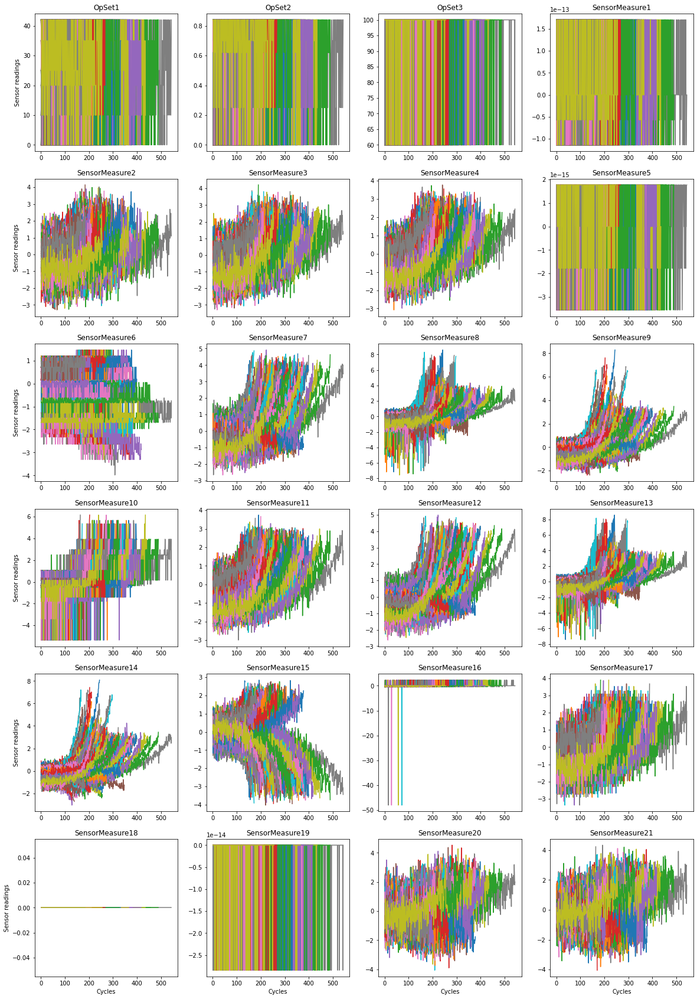

In [505]:
sensor_names = []
for i in range(3):
    sensor_names.append('OpSet' + str(i+1))
for i in range(21):
    sensor_names.append('SensorMeasure' + str(i+1))

fig, axs = plt.subplots(6, 4)
flat_axs = axs.flatten()
for sensor in range(2, 26):
    flat_axs[sensor - 2].set_title(sensor_names[sensor - 2])
    for engine in range(len(new_train_arr)):
        flat_axs[sensor - 2].plot(new_train_arr[engine][:, 1], new_train_arr[engine][:, sensor])

plt.setp(axs[-1, :], xlabel='Cycles')
plt.setp(axs[:, 0], ylabel='Sensor readings')
fig.set_size_inches(20, 30) 
plt.savefig('fd004-sensors_scaled.jpg')
plt.show()

### Save to csv - Scaled dataset

In [506]:
joined_train.to_csv('./fd004-scaled_train_data.csv', sep=' ', columns=joined_train.columns, index=False)
joined_test.to_csv('./fd004-scaled_test_data.csv', sep=' ', columns=joined_test.columns, index=False)

### Smoothing (Noise filtering) - Different datasets may be suited to more or less smoothing

In [507]:
joined_train.reset_index(drop=True)
joined_test.reset_index(drop=True)

new_train = joined_train.groupby(['ID'], sort=False)
new_test = joined_test.groupby(['ID'], sort=False)

last_train = new_train.last().min().round()
last_test = new_test.last().min().round()

Rolling average smoothing

In [508]:
# rolling_avg_length = 50
# smoothed_dfs_train = []
# for i in range(len(new_train)):
#     df_smoothed = new_train.get_group(i+1).rolling(window = rolling_avg_length, min_periods = 1).mean()
#     smoothed_dfs_train.append(df_smoothed)

# smoothed_dfs_train_np = []
# for i in range(len(smoothed_dfs_train)):
#     smoothed_dfs_train_np.append(smoothed_dfs_train[i].to_numpy())

# smoothed_dfs_test = []
# for i in range(len(new_test)):
#     df_smoothed = new_train.get_group(i+1).rolling(window = rolling_avg_length, min_periods = 1).mean()
#     smoothed_dfs_test.append(df_smoothed)

# smoothed_dfs_test_np = []
# for i in range(len(smoothed_dfs_test)):
#     smoothed_dfs_test_np.append(smoothed_dfs_test[i].to_numpy())
    

Exponential smoothing

In [509]:
smoothed_dfs_train = []
for i in range(len(new_train)):
    df_original = new_train.get_group(i+1).reset_index(drop=True)
    df_smoothed = df_original.ewm(alpha = 0.75, adjust=False).mean()
    smoothed_dfs_train.append(df_smoothed)

smoothed_dfs_train_np = []
for i in range(len(smoothed_dfs_train)):
    smoothed_dfs_train_np.append(smoothed_dfs_train[i].to_numpy())

smoothed_dfs_test = []
for i in range(len(new_test)):
    df_original = new_test.get_group(i+1).reset_index(drop=True)
    df_smoothed = df_original.ewm(alpha = 0.75, adjust=False).mean()
    smoothed_dfs_test.append(df_smoothed)

smoothed_dfs_test_np = []
for i in range(len(smoothed_dfs_test)):
    smoothed_dfs_test_np.append(smoothed_dfs_test[i].to_numpy())

In [510]:
smoothed_dfs_train[0]

,ID,Cycle,OpSet1,OpSet2,OpSet3,SensorMeasure1,SensorMeasure2,SensorMeasure3,SensorMeasure4,SensorMeasure5,...,SensorMeasure12,SensorMeasure13,SensorMeasure14,SensorMeasure15,SensorMeasure16,SensorMeasure17,SensorMeasure18,SensorMeasure19,SensorMeasure20,SensorMeasure21
0,1.0,1.000000,42.000000,0.840000,100.0,0.000000e+00,0.435226,-1.384552,-1.281826,1.776357e-15,...,-1.092784,-0.385998,-0.945381,0.022482,3.469447e-18,-0.327372,0.0,0.000000e+00,-0.024003,-0.079914
1,1.0,1.750000,25.500000,0.735000,100.0,1.278977e-13,-1.745476,-1.012124,-1.338331,1.776357e-15,...,-1.380029,-1.526966,-1.266434,0.014673,-3.284567e-01,-1.789924,0.0,0.000000e+00,-0.711718,-0.495843
2,1.0,2.687500,37.875000,0.813750,100.0,3.197442e-14,-1.289072,-1.326693,-0.953347,1.776357e-15,...,-1.290152,-0.729399,-1.392266,0.718906,-8.211417e-02,-1.144504,0.0,0.000000e+00,-1.080979,0.387311
3,1.0,3.671875,40.968750,0.833438,100.0,7.993606e-15,-1.578780,-1.619096,-0.775608,1.776357e-15,...,-1.126431,-0.384610,-1.002623,0.231922,-2.052854e-02,-1.434644,0.0,0.000000e+00,-0.793988,0.569177
4,1.0,4.667969,28.992188,0.673359,70.0,-4.063416e-14,-1.635819,-1.106426,-1.516327,1.776357e-15,...,-0.882186,-0.869904,-1.026952,-0.229406,-5.132135e-03,-1.312693,0.0,-2.131628e-14,-1.837932,1.007688
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
316,1.0,316.666667,8.320785,0.168162,100.0,2.125233e-15,1.546537,1.697860,1.248541,-2.530095e-15,...,3.246953,2.397927,2.552664,-2.150550,2.613525e-05,2.044863,0.0,-7.942903e-23,2.211513,1.987059
317,1.0,317.666667,9.580196,0.229541,100.0,-8.473382e-14,1.633070,1.492164,1.669439,-6.325237e-16,...,3.541907,3.007773,2.648579,-2.425218,1.562814e-02,2.698942,0.0,-1.985726e-23,1.073355,2.193197
318,1.0,318.666667,9.895049,0.244885,100.0,-1.064486e-13,1.263119,1.790654,1.190891,-1.581309e-16,...,3.615646,3.442739,2.574486,-2.628291,1.952865e-02,2.407741,0.0,-4.964315e-24,1.179108,2.052388
319,1.0,319.666667,17.473762,0.586221,100.0,1.012855e-13,0.187819,1.959861,1.701212,1.292735e-15,...,3.912060,3.483506,2.700876,-2.835249,1.717437e+00,2.019042,0.0,-1.241079e-24,1.872449,2.680686


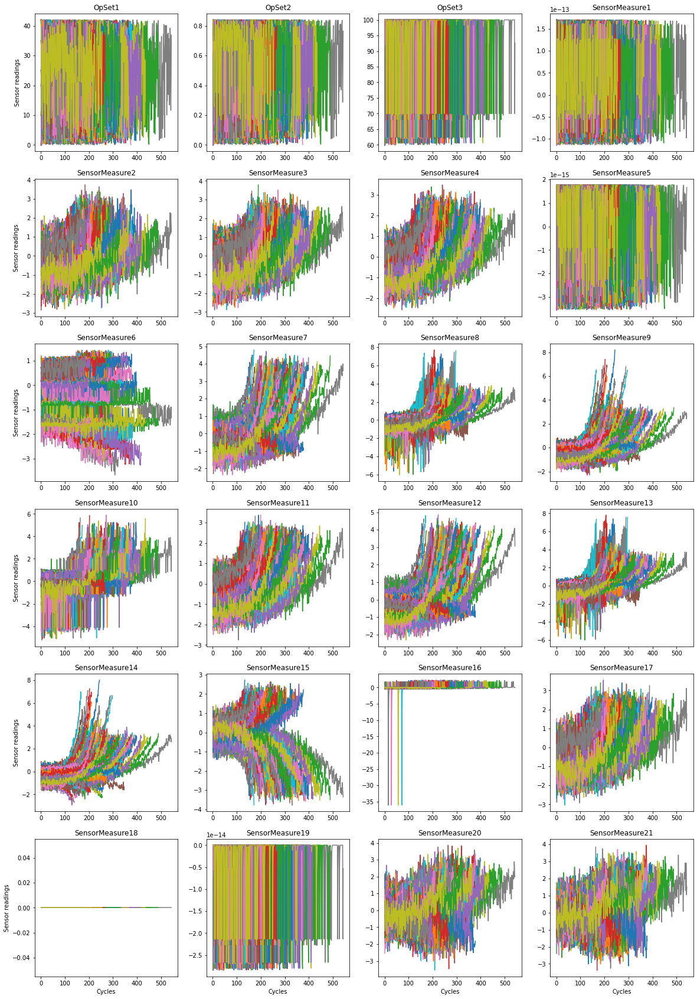

In [511]:
fig, axs = plt.subplots(6, 4)
flat_axs = axs.flatten()
for sensor in range(2, 26):
    flat_axs[sensor - 2].set_title(sensor_names[sensor - 2])
    for engine in range(len(smoothed_dfs_train_np)):
        flat_axs[sensor - 2].plot(smoothed_dfs_train_np[engine][:, 1], smoothed_dfs_train_np[engine][:, sensor])

plt.setp(axs[-1, :], xlabel='Cycles')
plt.setp(axs[:, 0], ylabel='Sensor readings')
fig.set_size_inches(20, 30) 
plt.savefig('fd004-sensors_smoothed.jpg')
plt.show()

In [512]:
joined_train_smoothed = smoothed_dfs_train[0]
for i in range(1, len(smoothed_dfs_train)):
    joined_train_smoothed = pd.concat([joined_train_smoothed, smoothed_dfs_train[i]], ignore_index=True)
joined_train_smoothed = joined_train_smoothed.sort_values(by =['ID', 'Cycle'])

joined_test_smoothed = smoothed_dfs_test[0]
for i in range(1, len(smoothed_dfs_test)):
    joined_test_smoothed = pd.concat([joined_test_smoothed, smoothed_dfs_test[i]], ignore_index=True)
joined_test_smoothed = joined_test_smoothed.sort_values(by =['ID', 'Cycle'])

In [513]:
joined_train_smoothed

,ID,Cycle,OpSet1,OpSet2,OpSet3,SensorMeasure1,SensorMeasure2,SensorMeasure3,SensorMeasure4,SensorMeasure5,...,SensorMeasure12,SensorMeasure13,SensorMeasure14,SensorMeasure15,SensorMeasure16,SensorMeasure17,SensorMeasure18,SensorMeasure19,SensorMeasure20,SensorMeasure21
0,1.0,1.000000,42.000000,0.840000,100.000000,0.000000e+00,0.435226,-1.384552,-1.281826,1.776357e-15,...,-1.092784,-0.385998,-0.945381,0.022482,3.469447e-18,-0.327372,0.0,0.000000e+00,-0.024003,-0.079914
1,1.0,1.750000,25.500000,0.735000,100.000000,1.278977e-13,-1.745476,-1.012124,-1.338331,1.776357e-15,...,-1.380029,-1.526966,-1.266434,0.014673,-3.284567e-01,-1.789924,0.0,0.000000e+00,-0.711718,-0.495843
2,1.0,2.687500,37.875000,0.813750,100.000000,3.197442e-14,-1.289072,-1.326693,-0.953347,1.776357e-15,...,-1.290152,-0.729399,-1.392266,0.718906,-8.211417e-02,-1.144504,0.0,0.000000e+00,-1.080979,0.387311
3,1.0,3.671875,40.968750,0.833438,100.000000,7.993606e-15,-1.578780,-1.619096,-0.775608,1.776357e-15,...,-1.126431,-0.384610,-1.002623,0.231922,-2.052854e-02,-1.434644,0.0,0.000000e+00,-0.793988,0.569177
4,1.0,4.667969,28.992188,0.673359,70.000000,-4.063416e-14,-1.635819,-1.106426,-1.516327,1.776357e-15,...,-0.882186,-0.869904,-1.026952,-0.229406,-5.132135e-03,-1.312693,0.0,-2.131628e-14,-1.837932,1.007688
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61244,249.0,250.666667,14.554492,0.354607,92.500000,-9.392312e-14,1.197240,2.278567,0.993453,4.440425e-16,...,3.320038,2.869142,2.960538,-2.647544,4.238197e-02,1.401175,0.0,-5.329071e-15,2.326998,2.529808
61245,249.0,251.666667,3.638623,0.088652,98.125000,-2.348078e-14,1.645466,1.732769,1.906960,-2.553525e-15,...,3.571580,2.613948,2.699207,-2.852849,1.059549e-02,1.796756,0.0,-1.332268e-15,1.773503,2.239443
61246,249.0,252.666667,0.909656,0.022163,99.531250,-5.870195e-15,2.136613,2.580414,2.427433,-3.302916e-15,...,3.723655,2.651044,3.028904,-2.530642,2.648873e-03,1.460846,0.0,-3.330669e-16,2.817016,2.718082
61247,249.0,253.666667,26.477414,0.635541,99.882812,1.264301e-13,0.851661,2.574161,2.335689,-2.157997e-15,...,3.561611,2.548769,3.204679,-3.189345,6.622183e-04,1.875259,0.0,-8.326673e-17,2.807376,2.054378
